# Differentiating Precipitation and Blowing Snow During Winter 2023 Using SAIL Ceilometer Data

Author: Daniel Hogan
Created: June 13, 2024

This notebook will look at conditions in the lower atmosphere during different days over the 2023 campaign to distinguish when snow was falling vs. when it was blowing vs. when it was falling and blowing.
I'll seek to do this by trying to do this by using ceilometer data from SAIL, blowing snow data from SOS, wind speed data from SAIL, and laser disdrometer data during 3 types of conditions:
1) A clear day with blowing snow.
2) A snowy day with no blowing snow.
3) A mixed day with both blowing snow and falling snow.

### Imports


In [204]:
# general
import os
import glob
import datetime as dt
import json
# data 
import xarray as xr 
from sublimpy import utils, variables, tidy, turbulence
import numpy as np
import pandas as pd
from act import discovery, plotting
# plotting
import matplotlib.pyplot as plt
from metpy.cbook import get_test_data
from metpy.plots import add_metpy_logo, SkewT
import plotly.express as px 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
# helper tools
from scripts.get_sail_data import get_sail_data
from scripts.helper_funcs import create_windrose_df, simple_sounding, mean_sounding
import scripts.helper_funcs as hf
from metpy import calc, units
# make plotly work 
init_notebook_mode(connected=True)
cf.go_offline()
# stats
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.metrics import f1_score
from sklearn.base import BaseEstimator, ClassifierMixin

# Gather Necessary Datasets

In [19]:
# laser disdrometer data
w23_ld_gts_ds = xr.open_dataset('/storage/dlhogan/synoptic_sublimation/sail_data/winter_22_23/laser_disdrometer_gothic_20221001_20230930.nc')
w23_prcp_rate_gts_ds = w23_ld_gts_ds.sel(time=slice('2022-12-01', '2023-03-31'))[['precip_rate', 'qc_precip_rate']].to_dataframe().resample('5min').mean().to_xarray()

# winter 2022 laser disdrometer data
w22_ld_gts_ds = xr.open_dataset('/storage/dlhogan/synoptic_sublimation/sail_data/winter_21_22/laser_disdrometer_gothic_20211001_20220930.nc')
w22_prcp_rate_gts_ds = w22_ld_gts_ds.sel(time=slice('2021-12-01', '2022-03-31'))[['precip_rate', 'qc_precip_rate']].to_dataframe().resample('5min').mean().to_xarray()

# blowing snow data
sos_ds_5min = xr.open_dataset('../../01_data/processed_data/sos_ds_5min_storage.nc')
sos_ds_5min = sos_ds_5min.sel(time=slice('2022-12-01', '2023-03-31')).to_dataframe().resample('5min').mean().to_xarray()

# wind data
w23_sail_met = xr.open_dataset('/storage/dlhogan/synoptic_sublimation/sail_data/winter_22_23/met_20221001_20230930.nc')
w23_sail_met = w23_sail_met.sel(time=slice('2022-12-01', '2023-03-31')).drop_dims('bound').to_dataframe().resample('5min').mean().to_xarray()

# SPLASH ceilometer data
SPLASH_kp_ceil = xr.open_dataset('/storage/dlhogan/synoptic_sublimation/splash_data/ceilometer/splash_kp_ceilometer.nc').sel(time=slice('2022-10-01','2023-03-31'))

# SPLASH laser disdrometer data
w23_SPLASH_kp_ld = xr.open_dataset('../../01_data/processed_data/splash/wy23_resampled_5min_SPLASH_kp_ldis.nc').sel(time=slice('2022-10-01','2023-03-31'))


In [20]:
# get the three variables I need
sos_blowing_snow = (sos_ds_5min['SF_avg_1m_ue'] + sos_ds_5min['SF_avg_2m_ue']).to_pandas()
sos_blowing_snow.name = 'blowing_snow'
sos_10m_wind = sos_ds_5min['spd_10m_c'].to_pandas()
sos_10m_wind.name = 'wspd_kp'
sail_10m_wind = w23_sail_met['wspd_vec_mean'].to_pandas()
sail_10m_wind.name = 'wspd_gts'
sail_ld_prcp = w23_prcp_rate_gts_ds['precip_rate'].to_pandas()
sail_ld_prcp.name = 'precip_rate'

df = pd.concat([sos_blowing_snow, sail_10m_wind, sos_10m_wind, sail_ld_prcp], axis=1)


### Plots of Variables

In [21]:
# make a 3- panel plot in plotly
fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=('Blowing Snow', '10m Wind Speed', 'Laser Disdrometer Precipitation Rate'), vertical_spacing=0.05)

# blowing snow
fig.add_trace(go.Scatter(x=df.index, y=np.log10(df['blowing_snow']), mode='lines', name='blowing snow'), row=1, col=1)
# wind speed
fig.add_trace(go.Scatter(x=df.index, y=df['wspd_kp'], mode='lines', name='10m wind speed (KP)'), row=2, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['wspd_gts'], mode='lines', name='10m wind speed (GTS)'), row=2, col=1)
# add legend 

# precipitation rate
fig.add_trace(go.Scatter(x=df.index, y=df['precip_rate'], mode='lines', name='precipitation rate'), row=3, col=1)

fig.update_layout(width=1000, height=700)
# decrease the spacing between the subplots
fig.update_layout(margin=dict(l=20, r=20, t=20, b=20), showlegend=True)

divide by zero encountered in log10


In [32]:
# filter to days with no blowing snow, but with precipitation
# filter to days with no blowing snow, but with precipitation
days_with_no_bs = df.resample('1D').sum()[df.resample('1D').sum()['blowing_snow'] == 0].index
df_nbs = df.copy()
df_nbs['date'] = pd.to_datetime(df_nbs.index.date)
df_nbs = df_nbs[df_nbs['date'].isin(days_with_no_bs)]
# make a 3- panel plot in plotly
fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=('Blowing Snow', '10m Wind Speed', 'Laser Disdrometer Precipitation Rate'), vertical_spacing=0.05)

# blowing snow
fig.add_trace(go.Scatter(x=df_nbs.index, y=np.log10(df_nbs['blowing_snow']), mode='lines', name='blowing snow'), row=1, col=1)
# wind speed
fig.add_trace(go.Scatter(x=df_nbs.index, y=df_nbs['wspd_gts'], mode='lines', name='10m wind speed'), row=2, col=1)
# precipitation rate
fig.add_trace(go.Scatter(x=df_nbs.index, y=df_nbs['precip_rate'], mode='lines', name='precipitation rate'), row=3, col=1)

fig.update_layout(width=1000, height=700)
# decrease the spacing between the subplots
fig.update_layout(margin=dict(l=20, r=20, t=20, b=20), showlegend=False)

divide by zero encountered in log10


In [34]:
# filter to days with no blowing snow, but with precipitation
days_with_no_precip = df.resample('1D').sum()[df.resample('1D').sum()['precip_rate'] < 5].index
df_noprcp = df.copy()
df_noprcp['date'] = pd.to_datetime(df_noprcp.index.date)
df_noprcp = df_noprcp[df_noprcp['date'].isin(days_with_no_precip)]
# make a 3- panel plot in plotly
fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=('Blowing Snow', '10m Wind Speed', 'Laser Disdrometer Precipitation Rate'), vertical_spacing=0.05)

# blowing snow
fig.add_trace(go.Scatter(x=df_noprcp.index, y=np.log10(df_noprcp['blowing_snow']), mode='lines', name='blowing snow'), row=1, col=1)
# wind speed
fig.add_trace(go.Scatter(x=df_noprcp.index, y=df_noprcp['wspd_gts'], mode='lines', name='10m wind speed'), row=2, col=1)
# precipitation rate
fig.add_trace(go.Scatter(x=df_noprcp.index, y=df_noprcp['precip_rate'], mode='lines', name='precipitation rate'), row=3, col=1)

fig.update_layout(width=1000, height=700)
# decrease the spacing between the subplots
fig.update_layout(margin=dict(l=20, r=20, t=20, b=20), showlegend=False)

divide by zero encountered in log10


### Download the Ceilometer Data

In [23]:
winter_22 = ('20211201','20220401')
winter_23 = ('20221201','20230401')

In [24]:
# Function to load ARM credentials
def load_arm_credentials(credential_path):
    with open(credential_path, 'r') as f:
        credentials = json.load(f)
    return credentials
# Location of ARM credentials
credential_path = '/home/dlhogan/.act_config.json'
credentials = load_arm_credentials(credential_path)
# api token and username for ARM
api_username = credentials.get('username')
api_token = credentials.get('token')

sail_datastream_dict = {
    "ceilometer":"gucceil10mM1.b1",
}

In [25]:
# Set the location of the data folder where this data will be stored
winter_22_folder = 'winter_21_22'
winter_23_folder = 'winter_22_23'
 # change to location of data folder on your machine
storage_directory = f'/storage/dlhogan/synoptic_sublimation/'


### Download winter 2022 data from SAIL
For now we will just get met, ecor, and laser disdrometer data

In [27]:
# load in the winter 22 data
sail_winter_22_folder = os.path.join(storage_directory,'sail_data',winter_22_folder)
# create empty data dictionary
w22_data_loc_dict = {}
# Iterate through the dictionary and pull the data for each datastream
for k,v in sail_datastream_dict.items():
   if (os.path.exists(f'{sail_winter_22_folder}/{k}_{winter_22[0]}_{winter_22[1]}.nc')): 
        print(f'{k}_{winter_23[0]}_{winter_23[1]}.nc already exists')
        print('-------------------')
        # add the filename to the dictionary which can be used if we want to load the data
        w22_data_loc_dict[k] = os.path.join(sail_winter_22_folder,f'{k}_{winter_22[0]}_{winter_22[1]}.nc')
        continue
   else:
      ds = get_sail_data(api_username,
                           api_token,
                           v,
                           startdate=winter_22[0],
                           enddate=winter_22[1],
                           resample='5min')
      ds.to_netcdf(f'{sail_winter_22_folder}/{k}_{winter_22[0]}_{winter_22[1]}.nc')
      w22_data_loc_dict[k] = os.path.join(sail_winter_22_folder,f'{k}_{winter_22[0]}_{winter_22[1]}.nc')

ceilometer_20221201_20230401.nc already exists
-------------------


### Download winter 2023 data from SAIL
For now we will just get met, ecor, and laser disdrometer data

In [28]:
# load in the winter 23 data
sail_winter_23_folder = os.path.join(storage_directory,'sail_data',winter_23_folder)
# create empty data dictionary
w23_data_loc_dict = {}
# Iterate through the dictionary and pull the data for each datastream
for k,v in sail_datastream_dict.items():
   if (os.path.exists(f'{sail_winter_23_folder}/{k}_{winter_23[0]}_{winter_23[1]}.nc')): 
        print(f'{k}_{winter_23[0]}_{winter_23[1]}.nc already exists')
        print('-------------------')
        # add the filename to the dictionary which can be used if we want to load the data
        w23_data_loc_dict[k] = os.path.join(sail_winter_23_folder,f'{k}_{winter_23[0]}_{winter_23[1]}.nc')
        continue
   else:
      ds = get_sail_data(api_username,
                           api_token,
                           v,
                           startdate=winter_23[0],
                           enddate=winter_23[1],
                           resample='5min')
      ds.to_netcdf(f'{sail_winter_23_folder}/{k}_{winter_23[0]}_{winter_23[1]}.nc')
      w23_data_loc_dict[k] = os.path.join(sail_winter_23_folder,f'{k}_{winter_23[0]}_{winter_23[1]}.nc')

ceilometer_20221201_20230401.nc already exists
-------------------


# Ceilometer Investigation - Case Studies

### Begin by comparing ceilometers with what clear, non-windy days look like

In [123]:
# Get clear and no blowing snow days
df_clear_nobs = df.resample('1D').sum()
df_clear_nobs = df_clear_nobs[(df_clear_nobs['blowing_snow'] == 0) & (df_clear_nobs['precip_rate'] == 0)]

df_precip = df.resample('1D').sum()
df_precip = df_precip[df_precip['precip_rate'] > 0]

df_bs = df.resample('1D').sum()
df_bs = df_bs[df_bs['blowing_snow'] > 0]


In [339]:
# get ceilometer data from these days
# compare the range gate around 100 meters above the surface
test_df = df_clear_nobs
range_choice = 9
SPLASH_kp_ceil_test = SPLASH_kp_ceil.isel(range=range_choice).drop_dims('cloud_layer').where(SPLASH_kp_ceil['time'].dt.date.isin(test_df.index.date), drop=True)
SAIL_gts_ceil_test = xr.open_dataset(w23_data_loc_dict['ceilometer'])
SAIL_gts_ceil_test = SAIL_gts_ceil_test.isel(range=range_choice).where(SAIL_gts_ceil_test['time'].dt.date.isin(test_df.index.date), drop=True)


In [340]:

SPLASH_kp_ceil_test_100m = SPLASH_kp_ceil_test['backscatter_profile']*1e-8
SAIL_gts_ceil_test_100m = SAIL_gts_ceil_test.where(SAIL_gts_ceil_test['backscatter']>=0)['backscatter']
# get the mean and standard deviation of the ceilometer data for each hour of the day
SPLASH_kp_ceil_test_100m_mean = SPLASH_kp_ceil_test_100m.groupby('time.hour').mean()
SPLASH_kp_ceil_test_100m_std_pos = SPLASH_kp_ceil_test_100m.groupby('time.hour').std() + SPLASH_kp_ceil_test_100m_mean
SPLASH_kp_ceil_test_100m_std_neg = SPLASH_kp_ceil_test_100m_mean - SPLASH_kp_ceil_test_100m.groupby('time.hour').std()
SAIL_gts_ceil_test_100m_mean = SAIL_gts_ceil_test_100m.groupby('time.hour').mean()
SAIL_gts_ceil_test_100m_std_pos = SAIL_gts_ceil_test_100m.groupby('time.hour').std() + SAIL_gts_ceil_test_100m_mean
SAIL_gts_ceil_test_100m_std_neg = SAIL_gts_ceil_test_100m_mean - SAIL_gts_ceil_test_100m.groupby('time.hour').std()
# make a plotly figure
fig = go.Figure([
    go.Scatter(
        name='SPLASH Ceilometer Mean',
        x=SPLASH_kp_ceil_test_100m_mean.hour,
        y=SPLASH_kp_ceil_test_100m_mean,
        mode='lines',
        line=dict(color='rgb(31, 119, 180)'),
    ),
    go.Scatter(
        name='Upper Bound',
        x=SPLASH_kp_ceil_test_100m_std_pos.hour,
        y=SPLASH_kp_ceil_test_100m_std_pos,
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        showlegend=False
    ),
    go.Scatter(
        name='Lower Bound',
        x=SPLASH_kp_ceil_test_100m_std_neg.hour,
        y=SPLASH_kp_ceil_test_100m_std_neg,
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        showlegend=False,
        fillcolor='rgba(68, 68, 68, 0.3)',
        fill='tonexty',
    ),
])

fig.add_trace(go.Scatter(
    name='SAIL Ceilometer Mean',
    x=SAIL_gts_ceil_test_100m_mean.hour,
    y=SAIL_gts_ceil_test_100m_mean,
    mode='lines',
    line=dict(color='rgb(255, 127, 14)'),
)
)
fig.add_trace(go.Scatter(
    name='Upper Bound',
    x=SAIL_gts_ceil_test_100m_std_pos.hour,
    y=SAIL_gts_ceil_test_100m_std_pos,
    mode='lines',
    marker=dict(color="#444"),
    line=dict(width=0),
    showlegend=False
))

fig.add_trace(go.Scatter(
    name='Lower Bound',
    x=SAIL_gts_ceil_test_100m_std_neg.hour,
    y=SAIL_gts_ceil_test_100m_std_neg,
    mode='lines',
    marker=dict(color="#444"),
    line=dict(width=0),
    showlegend=False,
    # light orange shading
    fillcolor='rgba(255, 127, 14, 0.3)',
    fill='tonexty',
))

# update the layout
fig.update_layout(title='Ceilometer Backscatter at 100m AGL', 
                  xaxis_title='Hour of Day', 
                      hovermode="x",
                  width=600, height=400)
# move legend to the top
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))

In [341]:
# for each day in SPLASH_kp_ceil_test_100m and SAIL_gts_ceil_test_100m, plot the boxplot of the log10 of the backscatter
# for each hour of the day
fig = go.Figure()
for i, day in enumerate(test_df.index[0:10].date):
    # get the data for each day
    SPLASH_kp_ceil_day = np.log10(SPLASH_kp_ceil_test_100m.where(SPLASH_kp_ceil_test_100m.time.dt.date == day).dropna('time'))
    SAIL_gts_ceil_day = np.log10(SAIL_gts_ceil_test_100m.where(SAIL_gts_ceil_test_100m.time.dt.date == day).dropna('time'))
    # make the boxplot for each day
    if i == 0:
        show_legend = True
    else: 
        show_legend = False
    fig.add_trace(go.Box(y=SPLASH_kp_ceil_day, x=[i]*len(SPLASH_kp_ceil_day), 
                         name='SPLASH Ceilometer', 
                         boxmean='sd', 
                         offsetgroup=0, 
                         showlegend=show_legend, 
                         marker_color='blue'))
    fig.add_trace(go.Box(y=SAIL_gts_ceil_day, x=[i]*len(SPLASH_kp_ceil_day), 
                         name='SAIL Ceilometer', 
                         boxmean='sd', 
                         offsetgroup=1, 
                         showlegend=show_legend,
                         marker_color='red'))
# update x ticks with the dates
fig.update_xaxes(tickvals=np.arange(0,i,1), ticktext=test_df.index[0:i].date)
fig.update_layout(title='Log10 of Ceilometer Backscatter at 100m AGL', 
                  yaxis_title='Log10 of Backscatter', 
                  xaxis_title='Day',
                  boxmode='group',
                  width=1500, height=600)


Trying a simple precipitation identification algorithm from the ceilometer data.

In [118]:
# ceilometer backscatter algorithm
# for each profile, calculate the slope between 60 and 120 meters
def backscatter_slope(x, r1, r2):
    m = (x.sel(range=r2, method='nearest') - x.sel(range=r1, method='nearest')) / (r2 - r1)
    return m
# first check if the backscatter of the second range bin is greater than the threshold
def precipitation_classificiation(backscatter_ds, mixed_event_threshold=500, backscatter_slope_threshold=3):
    # values less than this threshold are filled with 0s
    precipitation_classification = xr.where(backscatter_ds.sel(range=50, method='nearest') > mixed_event_threshold, x=1, y=0)

    precipitation_classification = xr.where((backscatter_slope(backscatter_ds, 50, 150) > backscatter_slope_threshold) & (precipitation_classification!=1), x=1, y=precipitation_classification)
    precipitation_classification['time'] = pd.to_datetime(precipitation_classification.time.values)
    return precipitation_classification

# Case Study 1: A day with no precipitation but with blowing snow

In [119]:
start = "20230306"
end = "20230307"
cs1_ds = get_sail_data(api_username,
                        api_token,
                        sail_datastream_dict['ceilometer'],
                        startdate=start,
                        enddate=end)

cs1_splash_ds = SPLASH_kp_ceil.sel(time=slice(start, start))

[DOWNLOADING] gucceil10mM1.b1.20230306.000015.nc


The variable(s) detection_status,status_flag,qc_first_cbh,qc_vertical_visibility,qc_second_cbh,qc_alt_highest_signal,qc_third_cbh,qc_laser_pulse_energy,qc_laser_temperature,qc_window_transmission,qc_tilt_angle,qc_background_light,qc_sum_backscatter have integer data type. Consider setting data type to float 'F64' or 'F32' using set_precision.


In [120]:
cs1_backscatter = cs1_ds.drop_dims("bound").resample(time='5min').mean()['backscatter'].isel(range=slice(1,50))
cs1_splash_backscatter = cs1_splash_ds.resample(time='5min').mean()['backscatter_profile'].isel(range=slice(1,50)) * 1e-8
cs1_prcp_classification = precipitation_classificiation(cs1_backscatter, mixed_event_threshold=500, backscatter_slope_threshold=3)
cs1_splash_prcp_classification = precipitation_classificiation(cs1_splash_backscatter, mixed_event_threshold=500, backscatter_slope_threshold=3)

invalid value encountered in log10
invalid value encountered in log10


Text(0.5, 1.0, 'Ceilometer Backscatter Difference between SAIL (Gothic)\nand SPLASH (KP) during Windy Event')

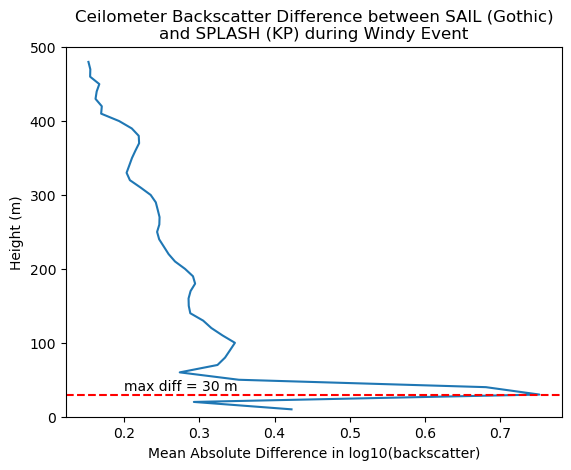

In [121]:
mean_absolute_difference = {}
for i in range(len(cs1_backscatter.range)):
    if i == 0:
        continue
    else:
        sail_ceil = cs1_backscatter.sel(range=cs1_backscatter.range[i], method='nearest')
        splash_ceil = cs1_splash_backscatter.sel(range=cs1_splash_backscatter.range[i], method='nearest')
        diff = np.log10(sail_ceil) - np.log10(splash_ceil)
        # calculate the mean absolute difference over each day
        mean_absolute_difference[i*10] = (np.abs(diff.mean().values))

    # plot the difference

plt.plot(list(mean_absolute_difference.values()), list(mean_absolute_difference.keys()))
# plot a horizontal line at the max differnce and label it with the height
plt.axhline(max(mean_absolute_difference, key=mean_absolute_difference.get), color='red', linestyle='--')
plt.text(0.2, max(mean_absolute_difference, key=mean_absolute_difference.get)+5, f'max diff = {max(mean_absolute_difference, key=mean_absolute_difference.get)} m')
plt.xlabel('Mean Absolute Difference in log10(backscatter)')
plt.ylabel('Height (m)')
plt.ylim(0, 500)
plt.title('Ceilometer Backscatter Difference between SAIL (Gothic)\nand SPLASH (KP) during Windy Event')

invalid value encountered in log10


[Text(0, 0, 'No Precipitation'), Text(0, 1, 'Precipitation')]

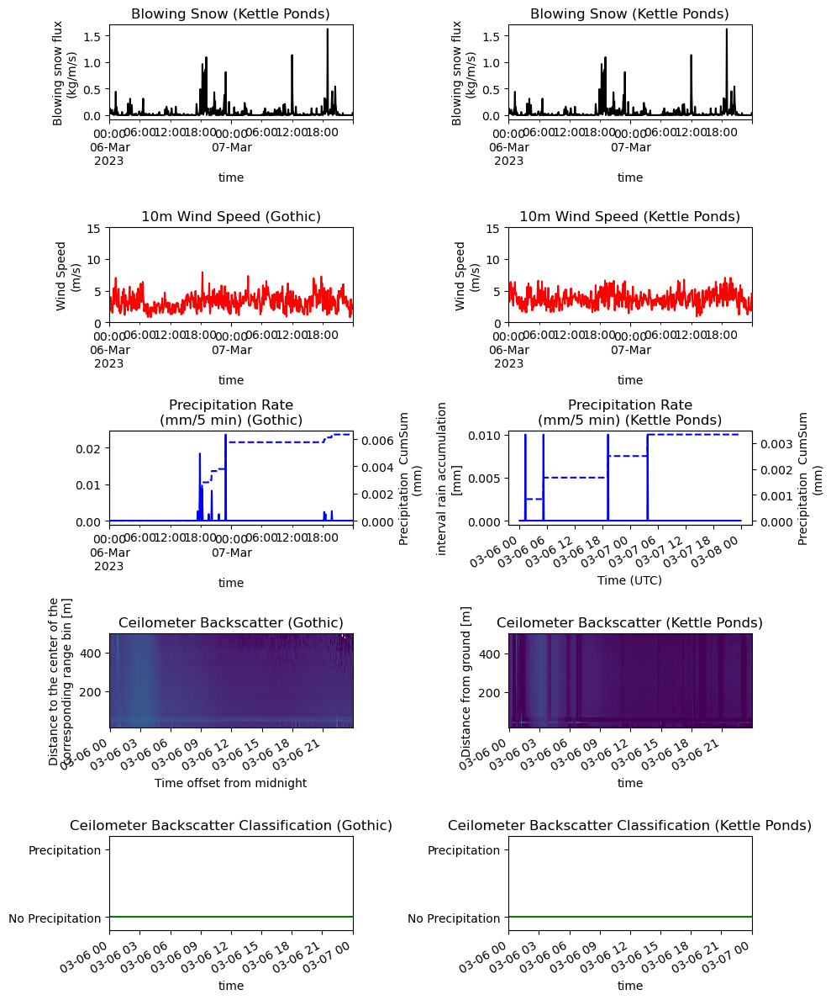

In [122]:
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(10, 12), tight_layout=True)

# plot blowing snow for these dates
df.loc[start:end]['blowing_snow'].plot(ax=axs[0,0], color='black')
axs[0,0].set_title('Blowing Snow (Kettle Ponds)')
axs[0,0].set_ylabel('Blowing snow flux\n(kg/m/s)')

# plot wind speed for these dates
df.loc[start:end]['wspd_gts'].plot(ax=axs[1,0], color='red')
axs[1,0].set_title('10m Wind Speed (Gothic)')
axs[1,0].set_ylabel('Wind Speed\n(m/s)')
axs[1,0].set_ylim(0,15)

# plot precipitation rate for these dates
df.loc[start:end]['precip_rate'].plot(ax=axs[2,0], color='blue')
ax2 = axs[2,0].twinx()
(df.loc[start:end]['precip_rate'].cumsum()/12).plot(ax=ax2, color='blue', linestyle='--')
ax2.set_ylabel('Precipitation  CumSum\n(mm) ')
axs[2,0].set_title('Precipitation Rate\n(mm/5 min) (Gothic)')

# plot ceilometer backscatter for these dates
im2 = np.log10(cs1_backscatter).plot.imshow(x='time', y='range',ax=axs[3,0], cmap='viridis', vmin=0, vmax=3, add_colorbar=False)
axs[3,0].set_title('Ceilometer Backscatter (Gothic)' )

# plot mwr liquid water path for these dates
cs1_prcp_classification.plot(ax=axs[4,0], color='green')
axs[4,0].set_title('Ceilometer Backscatter Classification (Gothic)')
axs[4,0].set_xlim(pd.Timestamp(start), pd.Timestamp(end))
axs[4,0].set_ylabel('')
axs[4,0].set_ylim(-0.2, 1.2)
# add yticks to be no precipitation or precipitation at 0 and 1
axs[4,0].set_yticks([0,1])
axs[4,0].set_yticklabels(['No Precipitation', 'Precipitation'])

# plot blowing snow for these dates
df.loc[start:end]['blowing_snow'].plot(ax=axs[0,1], color='black')
axs[0,1].set_title('Blowing Snow (Kettle Ponds)')
axs[0,1].set_ylabel('Blowing snow flux\n(kg/m/s)')

# plot wind speed for these dates
df.loc[start:end]['wspd_kp'].plot(ax=axs[1,1], color='red')
axs[1,1].set_title('10m Wind Speed (Kettle Ponds)')
axs[1,1].set_ylabel('Wind Speed\n(m/s)')
axs[1,1].set_ylim(0,15)

# plot precipitation rate for these dates
w23_SPLASH_kp_ld['Amount'].sel(time=slice(start,end)).isel(size_bins=0).plot(ax=axs[2,1], color='blue')
ax2 = axs[2,1].twinx()
(w23_SPLASH_kp_ld['Amount'].sel(time=slice(start,end)).isel(size_bins=0).cumsum()/12).plot(ax=ax2, color='blue', linestyle='--')
ax2.set_ylabel('Precipitation  CumSum\n(mm)')
ax2.set_title('')
axs[2,1].set_title('Precipitation Rate\n(mm/5 min) (Kettle Ponds)')

# plot ceilometer backscatter for these dates
im2 = np.log10(cs1_splash_backscatter).plot.imshow(x='time', y='range',ax=axs[3,1], cmap='viridis', vmin=0, vmax=3, add_colorbar=False)
axs[3,1].set_title('Ceilometer Backscatter (Kettle Ponds)')

# plot mwr liquid water path for these dates
cs1_splash_prcp_classification.plot(ax=axs[4,1], color='green')
axs[4,1].set_title('Ceilometer Backscatter Classification (Kettle Ponds)')
axs[4,1].set_xlim(pd.Timestamp(start), pd.Timestamp(end))
axs[4,1].set_ylabel('')
axs[4,1].set_ylim(-0.2, 1.2)
# add yticks to be no precipitation or precipitation at 0 and 1
axs[4,1].set_yticks([0,1])
axs[4,1].set_yticklabels(['No Precipitation', 'Precipitation'])


# Case Study 2: A day with no blowing snow but with precipitation

In [126]:
start = "20221230"
end = "20221230"
cs2_ds = get_sail_data(api_username,
                        api_token,
                        sail_datastream_dict['ceilometer'],
                        startdate=start,
                        enddate=end)
cs2_splash_ds = SPLASH_kp_ceil.sel(time=slice(start, start))

[DOWNLOADING] gucceil10mM1.b1.20221230.000005.nc


The variable(s) detection_status,status_flag,qc_first_cbh,qc_vertical_visibility,qc_second_cbh,qc_alt_highest_signal,qc_third_cbh,qc_laser_pulse_energy,qc_laser_temperature,qc_window_transmission,qc_tilt_angle,qc_background_light,qc_sum_backscatter have integer data type. Consider setting data type to float 'F64' or 'F32' using set_precision.


In [127]:
cs2_backscatter = cs2_ds.drop_dims("bound").resample(time='5min').mean()['backscatter'].isel(range=slice(1,50))
cs2_prcp_classification = precipitation_classificiation(cs2_backscatter)
cs2_splash_backscatter = cs2_splash_ds.resample(time='5min').mean()['backscatter_profile'].isel(range=slice(1,50)) * 1e-8
cs2_splash_prcp_classification = precipitation_classificiation(cs2_splash_backscatter)

invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encoun

Text(0.5, 1.0, 'Ceilometer Backscatter Difference between SAIL (Gothic)\nand SPLASH (KP) during Precipitation Event')

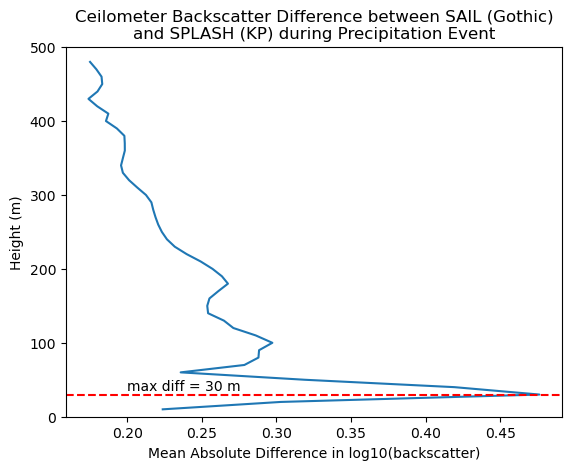

In [128]:
mean_absolute_difference = {}
for i in range(len(cs2_backscatter.range)):
    if i == 0:
        continue
    else:
        sail_ceil = cs2_backscatter.sel(range=cs2_backscatter.range[i], method='nearest')
        splash_ceil = cs2_splash_backscatter.sel(range=cs2_splash_backscatter.range[i], method='nearest')
        diff = np.log10(sail_ceil) - np.log10(splash_ceil)
        # calculate the mean absolute difference over each day
        mean_absolute_difference[i*10] = (np.abs(diff.mean().values))

    # plot the difference

plt.plot(list(mean_absolute_difference.values()), list(mean_absolute_difference.keys()))
# plot a horizontal line at the max differnce and label it with the height
plt.axhline(max(mean_absolute_difference, key=mean_absolute_difference.get), color='red', linestyle='--')
plt.text(0.2, max(mean_absolute_difference, key=mean_absolute_difference.get)+5, f'max diff = {max(mean_absolute_difference, key=mean_absolute_difference.get)} m')
plt.xlabel('Mean Absolute Difference in log10(backscatter)')
plt.ylabel('Height (m)')
plt.ylim(0, 500)
plt.title('Ceilometer Backscatter Difference between SAIL (Gothic)\nand SPLASH (KP) during Precipitation Event')

invalid value encountered in log10


[Text(0, 0, 'No Precipitation'), Text(0, 1, 'Precipitation')]

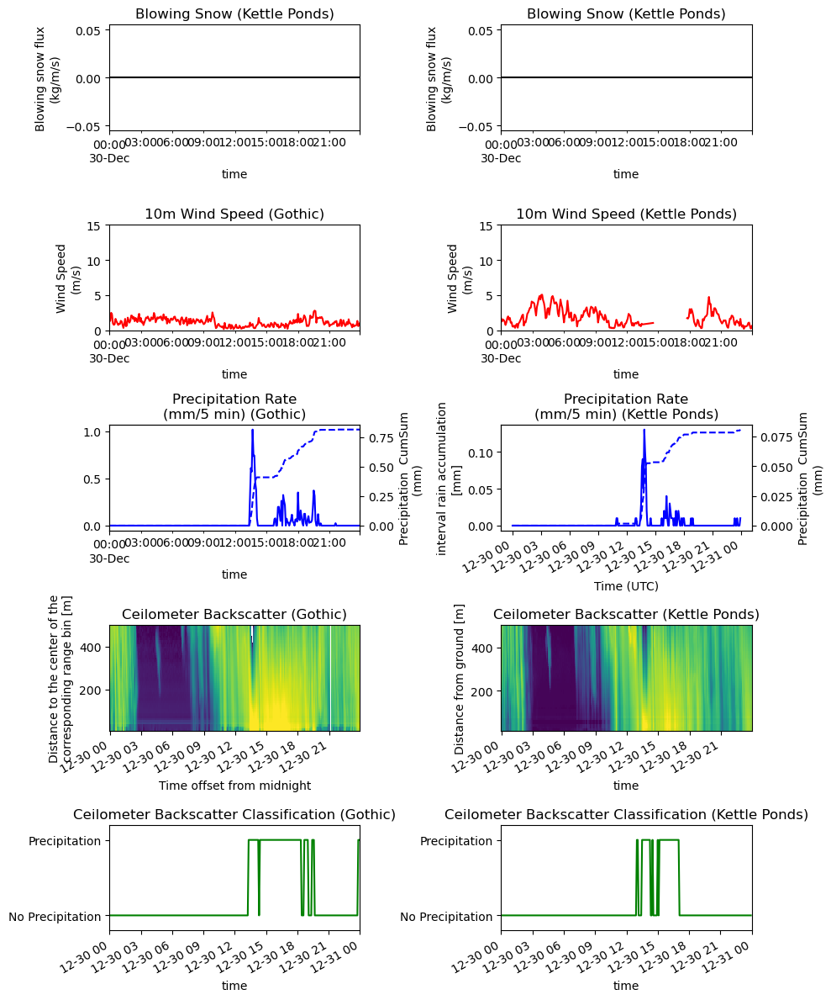

In [129]:
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(10, 12), tight_layout=True)

# plot blowing snow for these dates
df.loc[start:end]['blowing_snow'].plot(ax=axs[0,0], color='black')
axs[0,0].set_title('Blowing Snow (Kettle Ponds)')
axs[0,0].set_ylabel('Blowing snow flux\n(kg/m/s)')

# plot wind speed for these dates
df.loc[start:end]['wspd_gts'].plot(ax=axs[1,0], color='red')
axs[1,0].set_title('10m Wind Speed (Gothic)')
axs[1,0].set_ylabel('Wind Speed\n(m/s)')
axs[1,0].set_ylim(0,15)

# plot precipitation rate for these dates
df.loc[start:end]['precip_rate'].plot(ax=axs[2,0], color='blue')
ax2 = axs[2,0].twinx()
(df.loc[start:end]['precip_rate'].cumsum()/12).plot(ax=ax2, color='blue', linestyle='--')
ax2.set_ylabel('Precipitation  CumSum\n(mm) ')
axs[2,0].set_title('Precipitation Rate\n(mm/5 min) (Gothic)')

# plot ceilometer backscatter for these dates
im2 = np.log10(cs2_backscatter).plot.imshow(x='time', y='range',ax=axs[3,0], cmap='viridis', vmin=0, vmax=3, add_colorbar=False)
axs[3,0].set_title('Ceilometer Backscatter (Gothic)' )

# plot mwr liquid water path for these dates
cs2_prcp_classification.plot(ax=axs[4,0], color='green')
axs[4,0].set_title('Ceilometer Backscatter Classification (Gothic)')
axs[4,0].set_xlim(pd.Timestamp(start), pd.Timestamp('20221231'))
axs[4,0].set_ylabel('')
axs[4,0].set_ylim(-0.2, 1.2)
# add yticks to be no precipitation or precipitation at 0 and 1
axs[4,0].set_yticks([0,1])
axs[4,0].set_yticklabels(['No Precipitation', 'Precipitation'])

# plot blowing snow for these dates
df.loc[start:end]['blowing_snow'].plot(ax=axs[0,1], color='black')
axs[0,1].set_title('Blowing Snow (Kettle Ponds)')
axs[0,1].set_ylabel('Blowing snow flux\n(kg/m/s)')

# plot wind speed for these dates
df.loc[start:end]['wspd_kp'].plot(ax=axs[1,1], color='red')
axs[1,1].set_title('10m Wind Speed (Kettle Ponds)')
axs[1,1].set_ylabel('Wind Speed\n(m/s)')
axs[1,1].set_ylim(0,15)

# plot precipitation rate for these dates
w23_SPLASH_kp_ld['Amount'].sel(time=slice(start,end)).isel(size_bins=0).plot(ax=axs[2,1], color='blue')
ax2 = axs[2,1].twinx()
(w23_SPLASH_kp_ld['Amount'].sel(time=slice(start,end)).isel(size_bins=0).cumsum()/12).plot(ax=ax2, color='blue', linestyle='--')
ax2.set_ylabel('Precipitation  CumSum\n(mm)')
ax2.set_title('')
axs[2,1].set_title('Precipitation Rate\n(mm/5 min) (Kettle Ponds)')

# plot ceilometer backscatter for these dates
im2 = np.log10(cs2_splash_backscatter).plot.imshow(x='time', y='range',ax=axs[3,1], cmap='viridis', vmin=0, vmax=3, add_colorbar=False)
axs[3,1].set_title('Ceilometer Backscatter (Kettle Ponds)')

# plot mwr liquid water path for these dates
cs2_splash_prcp_classification.plot(ax=axs[4,1], color='green')
axs[4,1].set_title('Ceilometer Backscatter Classification (Kettle Ponds)')
axs[4,1].set_xlim(pd.Timestamp(start), pd.Timestamp('20221231'))
axs[4,1].set_ylabel('')
axs[4,1].set_ylim(-0.2, 1.2)
# add yticks to be no precipitation or precipitation at 0 and 1
axs[4,1].set_yticks([0,1])
axs[4,1].set_yticklabels(['No Precipitation', 'Precipitation'])


# Case Study 3: A mixed event

In [130]:
start = "20230222"
end = "20230222"
cs3_ds = get_sail_data(api_username,
                        api_token,
                        sail_datastream_dict['ceilometer'],
                        startdate=start,
                        enddate=end)
cs3_splash_ds = SPLASH_kp_ceil.sel(time=slice(start, start))

[DOWNLOADING] gucceil10mM1.b1.20230222.000000.nc


The variable(s) detection_status,status_flag,qc_first_cbh,qc_vertical_visibility,qc_second_cbh,qc_alt_highest_signal,qc_third_cbh,qc_laser_pulse_energy,qc_laser_temperature,qc_window_transmission,qc_tilt_angle,qc_background_light,qc_sum_backscatter have integer data type. Consider setting data type to float 'F64' or 'F32' using set_precision.


In [131]:
cs3_backscatter = cs3_ds.drop_dims("bound").resample(time='5min').mean()['backscatter'].isel(range=slice(1,50))
cs3_prcp_classification = precipitation_classificiation(cs3_backscatter)
cs3_splash_backscatter = cs3_splash_ds.resample(time='5min').mean()['backscatter_profile'].isel(range=slice(1,50)) * 1e-8
cs3_splash_prcp_classification = precipitation_classificiation(cs3_splash_backscatter)

invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encountered in log10
invalid value encoun

Text(0.5, 1.0, 'Ceilometer Backscatter Difference between SAIL (Gothic)\nand SPLASH (KP) during Windy Precipitation Event')

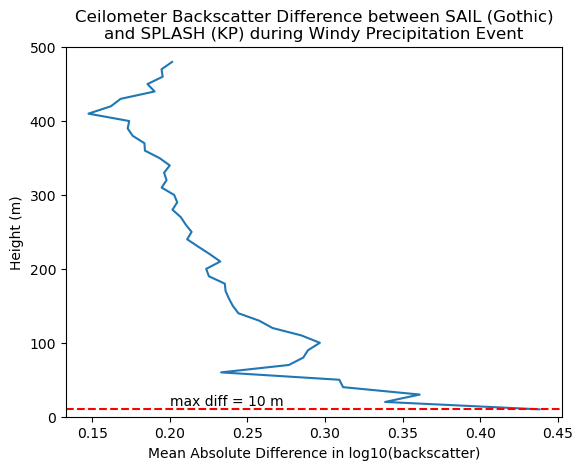

In [132]:
mean_absolute_difference = {}
for i in range(len(cs3_backscatter.range)):
    if i == 0:
        continue
    else:
        sail_ceil = cs3_backscatter.sel(range=cs3_backscatter.range[i], method='nearest')
        splash_ceil = cs3_splash_backscatter.sel(range=cs3_splash_backscatter.range[i], method='nearest')
        diff = np.log10(sail_ceil) - np.log10(splash_ceil)
        # calculate the mean absolute difference over each day
        mean_absolute_difference[i*10] = (np.abs(diff.mean().values))

    # plot the difference

plt.plot(list(mean_absolute_difference.values()), list(mean_absolute_difference.keys()))
# plot a horizontal line at the max differnce and label it with the height
plt.axhline(max(mean_absolute_difference, key=mean_absolute_difference.get), color='red', linestyle='--')
plt.text(0.2, max(mean_absolute_difference, key=mean_absolute_difference.get)+5, f'max diff = {max(mean_absolute_difference, key=mean_absolute_difference.get)} m')
plt.xlabel('Mean Absolute Difference in log10(backscatter)')
plt.ylabel('Height (m)')
plt.ylim(0, 500)
plt.title('Ceilometer Backscatter Difference between SAIL (Gothic)\nand SPLASH (KP) during Windy Precipitation Event')

invalid value encountered in log10


[Text(0, 0, 'No Precipitation'), Text(0, 1, 'Precipitation')]

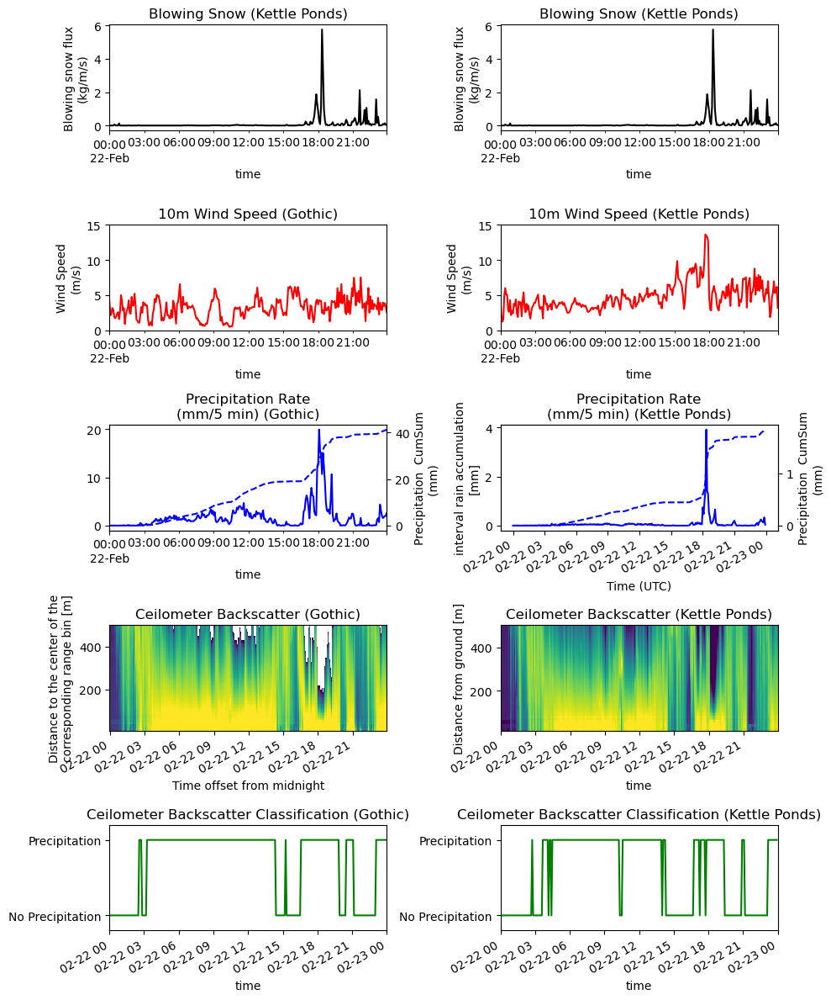

In [133]:
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(10, 12), tight_layout=True)

# plot blowing snow for these dates
df.loc[start:end]['blowing_snow'].plot(ax=axs[0,0], color='black')
axs[0,0].set_title('Blowing Snow (Kettle Ponds)')
axs[0,0].set_ylabel('Blowing snow flux\n(kg/m/s)')

# plot wind speed for these dates
df.loc[start:end]['wspd_gts'].plot(ax=axs[1,0], color='red')
axs[1,0].set_title('10m Wind Speed (Gothic)')
axs[1,0].set_ylabel('Wind Speed\n(m/s)')
axs[1,0].set_ylim(0,15)

# plot precipitation rate for these dates
df.loc[start:end]['precip_rate'].plot(ax=axs[2,0], color='blue')
ax2 = axs[2,0].twinx()
(df.loc[start:end]['precip_rate'].cumsum()/12).plot(ax=ax2, color='blue', linestyle='--')
ax2.set_ylabel('Precipitation  CumSum\n(mm) ')
axs[2,0].set_title('Precipitation Rate\n(mm/5 min) (Gothic)')

# plot ceilometer backscatter for these dates
im2 = np.log10(cs3_backscatter).plot.imshow(x='time', y='range',ax=axs[3,0], cmap='viridis', vmin=0, vmax=3, add_colorbar=False)
axs[3,0].set_title('Ceilometer Backscatter (Gothic)' )

# plot mwr liquid water path for these dates
cs3_prcp_classification.plot(ax=axs[4,0], color='green')
axs[4,0].set_title('Ceilometer Backscatter Classification (Gothic)')
axs[4,0].set_xlim(pd.Timestamp(start), pd.Timestamp('20230223'))
axs[4,0].set_ylabel('')
axs[4,0].set_ylim(-0.2, 1.2)
# add yticks to be no precipitation or precipitation at 0 and 1
axs[4,0].set_yticks([0,1])
axs[4,0].set_yticklabels(['No Precipitation', 'Precipitation'])

# plot blowing snow for these dates
df.loc[start:end]['blowing_snow'].plot(ax=axs[0,1], color='black')
axs[0,1].set_title('Blowing Snow (Kettle Ponds)')
axs[0,1].set_ylabel('Blowing snow flux\n(kg/m/s)')

# plot wind speed for these dates
df.loc[start:end]['wspd_kp'].plot(ax=axs[1,1], color='red')
axs[1,1].set_title('10m Wind Speed (Kettle Ponds)')
axs[1,1].set_ylabel('Wind Speed\n(m/s)')
axs[1,1].set_ylim(0,15)

# plot precipitation rate for these dates
w23_SPLASH_kp_ld['Amount'].sel(time=slice(start,end)).isel(size_bins=0).plot(ax=axs[2,1], color='blue')
ax2 = axs[2,1].twinx()
(w23_SPLASH_kp_ld['Amount'].sel(time=slice(start,end)).isel(size_bins=0).cumsum()/12).plot(ax=ax2, color='blue', linestyle='--')
ax2.set_ylabel('Precipitation  CumSum\n(mm)')
ax2.set_title('')
axs[2,1].set_title('Precipitation Rate\n(mm/5 min) (Kettle Ponds)')

# plot ceilometer backscatter for these dates
im2 = np.log10(cs3_splash_backscatter).plot.imshow(x='time', y='range',ax=axs[3,1], cmap='viridis', vmin=0, vmax=3, add_colorbar=False)
axs[3,1].set_title('Ceilometer Backscatter (Kettle Ponds)')

# plot mwr liquid water path for these dates
cs3_splash_prcp_classification.plot(ax=axs[4,1], color='green')
axs[4,1].set_title('Ceilometer Backscatter Classification (Kettle Ponds)')
axs[4,1].set_xlim(pd.Timestamp(start), pd.Timestamp('20230223'))
axs[4,1].set_ylabel('')
axs[4,1].set_ylim(-0.2, 1.2)
# add yticks to be no precipitation or precipitation at 0 and 1
axs[4,1].set_yticks([0,1])
axs[4,1].set_yticklabels(['No Precipitation', 'Precipitation'])


(0.0, 400.0)

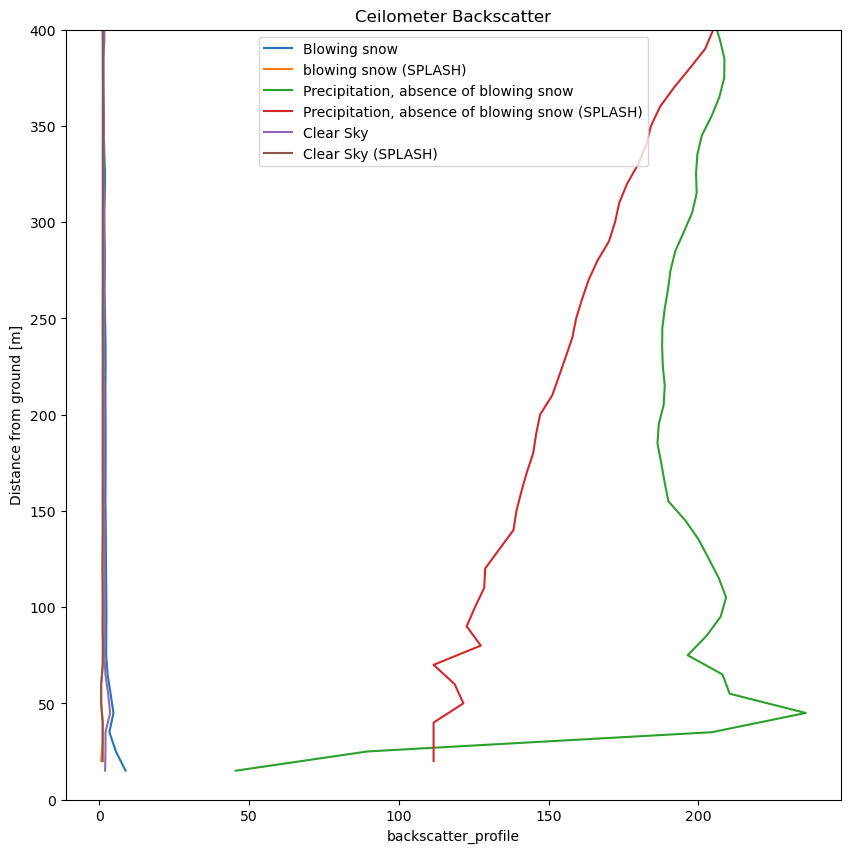

In [134]:
fig, ax = plt.subplots(figsize=(10, 10))
(((cs1_backscatter)).sel(time=f"2023-03-06T18:20:00")).plot(y='range', ax=ax, label='Blowing snow')
(((cs1_splash_backscatter)).sel(time=f"2023-03-06T18:00:00")).plot(y='range', ax=ax, label='blowing snow (SPLASH)')


(((cs2_backscatter)).sel(time=f"2022-12-30T12:00:00")).plot(y='range', ax=ax, label='Precipitation, absence of blowing snow')
(((cs2_splash_backscatter)).sel(time=f"2022-12-30T12:00:00")).plot(y='range', ax=ax, label='Precipitation, absence of blowing snow (SPLASH)')
# (((cs3_backscatter)).sel(time=f"2023-02-22T18:00:00")).plot(y='range', ax=ax, label='Blowing snow with precipitation')
(((cs2_backscatter)).sel(time=f"2022-12-30T06:00:00")).plot(y='range', ax=ax, label='Clear Sky')
(((cs2_splash_backscatter)).sel(time=f"2022-12-30T06:00:00")).plot(y='range', ax=ax, label='Clear Sky (SPLASH)')
ax.legend()
ax.set_title('Ceilometer Backscatter')
ax.set_ylim(0,400)
# ax.set_xlim(-10,1000)

# Optimize for Ceilometer Precipitation Identification
 
Here we use a grid search optimizing for a high F1-score, meaning both our precision and recall are high, however, I am weighting this score towards false negatives because I think there are more instances when the disdrometer says there was precipitation than there actually was.

### 2022 Confusion Matrix Plots between Disdrometer and Ceilometer

In [318]:
# ceilometer backscatter algorithm
# for each profile, calculate the slope between 60 and 120 meters
def backscatter_slope(x, r1, r2):
    m = (x.sel(range=r2, method='nearest') - x.sel(range=r1, method='nearest')) / (r2 - r1)
    return m
# first check if the backscatter of the second range bin is greater than the threshold
def precipitation_classifier(backscatter_ds, mixed_event_threshold=500, slope=2):
    # values less than this threshold are filled with 0s
    precipitation_classification = xr.where(backscatter_ds.sel(range=45, method='nearest') > mixed_event_threshold, x=1, y=0)

    precipitation_classification = xr.where((backscatter_slope(backscatter_ds, 15, 145) > slope) & (precipitation_classification!=1), x=1, y=precipitation_classification)
    precipitation_classification['time'] = pd.to_datetime(precipitation_classification.time.values)
    return precipitation_classification

# first check if the backscatter of the second range bin is greater than the threshold
# Define your function
def precipitation_classification_optimizer(ceil_ds, ld_ds, param1, param2):
    prcp_classification = precipitation_classifier(ceil_ds, mixed_event_threshold=param1, slope=param2).values
    # Here we simulate a function that outputs a confusion matrix
    # Replace this with your actual function logic
    # For example, let's say this function is a classifier:
    return confusion_matrix(prcp_classification, ld_ds.values)

# Define a scoring function
def fnr_scorer(estimator, X, y):
    param1 = estimator.param1
    param2 = estimator.param2
    cm = precipitation_classification_optimizer(X,y,param1, param2)
    TN, FP, FN, TP = cm.ravel()
    fnr = FN / (FN + TP)
    return -fnr  # Negative FNR because GridSearchCV maximizes the score by default
# Define a scoring function
# Define a custom scoring function
def custom_scorer(estimator, X, y):
    param1 = estimator.param1
    param2 = estimator.param2
    cm = precipitation_classification_optimizer(X, y, param1, param2)
    TN, FP, FN, TP = cm.ravel()
    custom_score = TP/(TP+0.5*(FP+FN*5)) 
    return custom_score

# Define the parameter grid
param_grid = {
    'param1': np.arange(100,1000,100),  # Range of values for mixed event threshold
    'param2': np.arange(0.5,4,0.5)   # Range of values for param2
}

# Create a custom estimator
class CustomEstimator:
    def __init__(self, param1=1, param2=2):
        self.param1 = param1
        self.param2 = param2

    def fit(self, X, y):
        self.X_ = X
        self.y_ = y
        return self

    def score(self, X, y):
        return custom_scorer(self, X, y)

    def get_params(self, deep=True):
        return {'param1': self.param1, 'param2': self.param2}

    def set_params(self, **params):
        for param, value in params.items():
            setattr(self, param, value)
        return self

### 2022

In [284]:
# SAIL 2022 Data
ceil_w22_ds = xr.open_dataset(w22_data_loc_dict['ceilometer'])
w22_sail_ld_precip_classificiation = xr.where(w22_prcp_rate_gts_ds.precip_rate>0, x=1, y=0)

# SPLASH laser disdrometer data
ceil_w22_splash_ds = xr.open_dataset('/storage/dlhogan/synoptic_sublimation/splash_data/ceilometer/splash_kp_ceilometer.nc').sel(time=slice('2021-12-01','2022-04-01'))
w22_SPLASH_kp_ld = xr.open_dataset('../../01_data/processed_data/splash/wy22_resampled_5min_SPLASH_kp_ldis.nc').sel(time=slice('2021-12-01','2022-04-01')).isel(size_bins=1)
w22_splash_ld_precip_classificiation = xr.where(w22_SPLASH_kp_ld['Amount']>0, x=1, y=0)

In [328]:
name = 'SPLASH'
X = ceil_w22_splash_ds['backscatter_profile'].isel(range=slice(1,50))*1e-8
y = w22_splash_ld_precip_classificiation.sel(time=X.time).dropna('time')
# Instantiate the grid search
grid_search = GridSearchCV(CustomEstimator(param1=1, param2=2), param_grid, scoring=custom_scorer)

# Run the grid search
grid_search.fit(X, y)

# Get the best parameters
best_params = grid_search.best_params_
print(f"Best parameters found for {name}: ", best_params)
# get the precipitation classification
ceil_splash_precipitation_classification_w22 = precipitation_classificiation(X, best_params['param1'], best_params['param2'])

Best parameters found for SPLASH:  {'param1': 400, 'param2': 3.0}


In [330]:
name = 'SAIL'
X = ceil_w22_ds['backscatter'].isel(range=slice(1,50))
y = w22_sail_ld_precip_classificiation.sel(time=X.time).dropna('time')
# Instantiate the grid search
grid_search = GridSearchCV(CustomEstimator(param1=1, param2=2), param_grid, scoring=custom_scorer)

# Run the grid search
grid_search.fit(X, y)

# Get the best parameters
best_params = grid_search.best_params_
print(f"Best parameters found for {name}: ", best_params)
# get the precipitation classification
ceil_precipitation_classification_w22 = precipitation_classificiation(X, best_params['param1'], best_params['param2'])

Best parameters found for SAIL:  {'param1': 400, 'param2': 3.5}


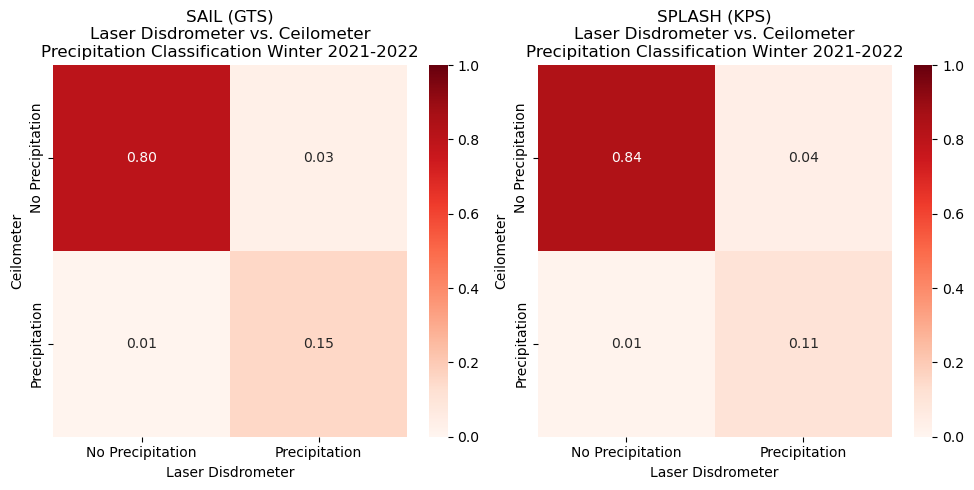

In [336]:
# make a confusion matrix for the ceilometer and laser disdrometer precipitation classifications
cm_for_plot_SAIL = pd.crosstab(ceil_precipitation_classification_w22.values, w22_sail_ld_precip_classificiation.values, rownames=['Ceilometer'], colnames=['Laser Disdrometer'])
# normalize between 0 and 1
cm_for_plot_SAIL = cm_for_plot_SAIL / cm_for_plot_SAIL.sum().sum()

cm_for_plot_SPLASH = pd.crosstab(ceil_splash_precipitation_classification_w22.values, w22_splash_ld_precip_classificiation.values, rownames=['Ceilometer'], colnames=['Laser Disdrometer'])
# normalize between 0 and 1
cm_for_plot_SPLASH = cm_for_plot_SPLASH / cm_for_plot_SPLASH.sum().sum()

# plot up the confusion matrix as a heatmap
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 5), tight_layout=True)
sns.heatmap(cm_for_plot_SAIL, annot=True, fmt='.2f', cmap='Reds', ax=axs[0],vmin=0, vmax=1)
sns.heatmap(cm_for_plot_SPLASH, annot=True, fmt='.2f', cmap='Reds', ax=axs[1],vmin=0, vmax=1)

# change x and y labels to have 0 be no precipitation and 1 be precipitation
names = ['SAIL (GTS)', 'SPLASH (KPS)']
for i, ax in enumerate(axs):
    ax.set_xticklabels(['No Precipitation', 'Precipitation'])
    ax.set_yticklabels(['No Precipitation', 'Precipitation'])
    ax.set_title(f'{names[i]}\nLaser Disdrometer vs. Ceilometer\nPrecipitation Classification Winter 2021-2022')

### 2023 Confusion Matrix Plots between Disdrometer and Ceilometer

In [299]:
# SAIL 2023 Data
ceil_w23_ds = xr.open_dataset(w23_data_loc_dict['ceilometer'])
ceil_w23_splash_ds = xr.open_dataset('/storage/dlhogan/synoptic_sublimation/splash_data/ceilometer/splash_kp_ceilometer.nc').sel(time=slice('2022-12-01','2023-04-01'))
w23_sail_ld_precip_classificiation = xr.where(w23_prcp_rate_gts_ds.precip_rate>0, x=1, y=0)

# SPLASH 2023 data
w23_SPLASH_kp_ld = xr.open_dataset('../../01_data/processed_data/splash/wy23_resampled_5min_SPLASH_kp_ldis.nc').sel(time=slice('2022-12-01','2023-04-01')).isel(size_bins=1)
w23_splash_ld_precip_classificiation = xr.where(w23_SPLASH_kp_ld['Amount']>0, x=1, y=0)

In [326]:
name = 'SPLASH'
X = ceil_w23_splash_ds['backscatter_profile'].isel(range=slice(1,50))*1e-8
y = w23_splash_ld_precip_classificiation.sel(time=X.time).dropna('time')
# Instantiate the grid search
grid_search = GridSearchCV(CustomEstimator(param1=1, param2=2), param_grid, scoring=custom_scorer)

# Run the grid search
grid_search.fit(X, y)

# Get the best parameters
best_params = grid_search.best_params_
print(f"Best parameters found for {name}: ", best_params)
# get the precipitation classification
ceil_splash_precipitation_classification_w23 = precipitation_classificiation(X, best_params['param1'], best_params['param2'])

Best parameters found for SPLASH:  {'param1': 300, 'param2': 3.5}


In [321]:
name = 'SPLASH'
X = ceil_w23_ds['backscatter'].isel(range=slice(1,50))
y = w23_sail_ld_precip_classificiation.sel(time=X.time).dropna('time')
# Instantiate the grid search
grid_search = GridSearchCV(CustomEstimator(param1=1, param2=2), param_grid, scoring=custom_scorer)

# Run the grid search
grid_search.fit(X, y)

# Get the best parameters
best_params = grid_search.best_params_
print(f"Best parameters found for {name}: ", best_params)
# get the precipitation classification
ceil_precipitation_classification_w23 = precipitation_classificiation(X, best_params['param1'], best_params['param2'])

Best parameters found for SPLASH:  {'param1': 500, 'param2': 3.5}


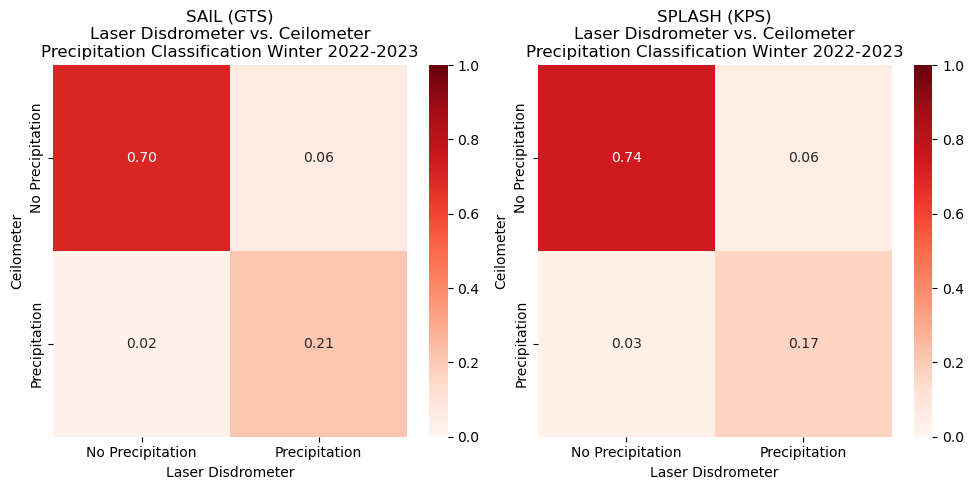

In [335]:
# make a confusion matrix for the ceilometer and laser disdrometer precipitation classifications
cm_for_plot_SAIL = pd.crosstab(ceil_precipitation_classification_w23.values, w23_sail_ld_precip_classificiation.values, rownames=['Ceilometer'], colnames=['Laser Disdrometer'])
# normalize between 0 and 1
cm_for_plot_SAIL = cm_for_plot_SAIL / cm_for_plot_SAIL.sum().sum()

cm_for_plot_SPLASH = pd.crosstab(ceil_splash_precipitation_classification_w23.values, w23_splash_ld_precip_classificiation.sel(time=ceil_w23_splash_ds.time).dropna('time').values, rownames=['Ceilometer'], colnames=['Laser Disdrometer'])
# normalize between 0 and 1
cm_for_plot_SPLASH = cm_for_plot_SPLASH / cm_for_plot_SPLASH.sum().sum()

# plot up the confusion matrix as a heatmap
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 5), tight_layout=True)
sns.heatmap(cm_for_plot_SAIL, annot=True, fmt='.2f', cmap='Reds', ax=axs[0], vmin=0, vmax=1)
sns.heatmap(cm_for_plot_SPLASH, annot=True, fmt='.2f', cmap='Reds', ax=axs[1], vmin=0, vmax=1)

# change x and y labels to have 0 be no precipitation and 1 be precipitation
names = ['SAIL (GTS)', 'SPLASH (KPS)']
for i, ax in enumerate(axs):
    ax.set_xticklabels(['No Precipitation', 'Precipitation'])
    ax.set_yticklabels(['No Precipitation', 'Precipitation'])
    ax.set_title(f'{names[i]}\nLaser Disdrometer vs. Ceilometer\nPrecipitation Classification Winter 2022-2023')

### Now, we have a general idea of when it was preciptiating vs. when it was not precipitating using the ceilometer. We are able to remove a number of periods when the laser disdrometer says it was precipitating but the ceilometer does not. We still have some error involved (around 1% of the time), but we have much higher error in the other case. 

In [338]:
# let's save each of the datasets to a netcdf file
# winter 22
ceil_precipitation_classification_w22.to_netcdf('../../01_data/processed_data/splash/ceilometer_precipitation_classification_w22.nc')
# splash winter 22
ceil_splash_precipitation_classification_w22.to_netcdf('../../01_data/processed_data/sail_processed/ceilometer_precipitation_classification_splash_w22.nc')
# winter 23
ceil_precipitation_classification_w23.to_netcdf('../../01_data/processed_data/sail_processed/ceilometer_precipitation_classification_w23.nc')
# splash winter 23
ceil_splash_precipitation_classification_w23.to_netcdf('../../01_data/processed_data/splash/ceilometer_precipitation_classification_splash_w23.nc')